In [ ]:
import base64
from wand.image import Image

view_high = '2400'
view_width = '1000'

svg_img_head = f'<svg xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" version="1.1" viewBox="0 0 {view_high} {view_width}" preserveAspectRatio="xMidYMid meet">'

svg_img_style = '''<style type="text/css">
@keyframes flickerAnimation5f434eec-e6f9-4af9-84b5-cc416fafbe79 { 0% {opacity: 1;} 100% { opacity: 0; }}
.foreground-svg { animation: 1s ease-in-out 0s alternate none infinite paused flickerAnimation5f434eec-e6f9-4af9-84b5-cc416fafbe79;}
.foreground-svg:hover { animation-play-state: running;}
</style>
'''

svg_img_body = '''    <g class="background-svg">
      <g transform="translate(0, 0) scale(1.0 1.0) ">
      <image xlink:href="{back_encode}" />
      </g>
    </g>
    <g class="foreground-svg">
      <g transform="translate(0, 0) scale(1.0 1.0) ">
      <image xlink:href="{fore_encode}" />
      </g>
    </g>
'''
svg_img_tail = '</svg>'


def encode_png(png_img):
    img = Image(filename=png_img)
    image_data = img.make_blob(format='png')
    encoded = base64.b64encode(image_data).decode()
    pngdata = 'data:image/png;base64,{}'.format(encoded)
    return pngdata

def write_svg(svg, png_back, png_fore):
    pngdata_back = encode_png(png_back)
    pngdata_fore = encode_png(png_fore)
    
    
    with open(svg, 'w') as f:
        f.write(svg_img_head)
        f.write(svg_img_style)
        f.write(svg_img_body.format(back_encode=pngdata_back, fore_encode=pngdata_fore))
        f.write(svg_img_tail)

write_svg('test1.svg', 'image1.png', 'image2.png')


In [35]:
import svgwrite
from PIL import Image

# 创建SVG画布
dwg = svgwrite.Drawing('image2.svg')

# 加载PNG图片
image1 = Image.open('image2.png')
# image2 = Image.open('image2.png')

# 将图片转换为SVG图像
svg_image1 = dwg.image(href='image2.png', size=("100%", "100%"),)
# svg_image2 = dwg.image(href='image2.png', size=("100%", "100%"),)

# # 创建一个动画对象
# anim = dwg.animate('opacity', dur='1s', repeatCount='indefinite')

# # 创建关键帧动画效果
# keyframe1 = dwg.animateMotion(path='M0 0 L100 100', dur='1s')
# keyframe2 = dwg.animateMotion(path='M100 100 L0 0', dur='1s')

# # 将关键帧动画效果添加到动画对象
# anim.add(keyframe1)
# anim.add([keyframe1, keyframe2])

# # 将动画对象应用到SVG图像
# svg_image1.add(anim)
# svg_image2.add(anim)

# 将SVG图像添加到画布
dwg.add(svg_image1)
# dwg.add(svg_image2)

# 保存SVG文件
dwg.save()

In [37]:
# example by https://github.com/stevenj to include bitmapgraphic by using the wand and base64 libraries
# getting wand at: https://pypi.org/project/Wand/
# requirements and installation: http://docs.wand-py.org/en/0.4.4/#
# not tested by myself (mozman)

import svgwrite
import base64
from wand.image import Image

# Load PNG Image
dwg = svgwrite.Drawing('image22.svg')
img = Image(filename="image2.png")

# Then get raw PNG data and encode DIRECTLY into the SVG file.
image_data = img.make_blob(format='png')
encoded = base64.b64encode(image_data).decode()
pngdata = 'data:image/png;base64,{}'.format(encoded)

image = dwg.add(dwg.image(href=(pngdata)))

# img = Image(filename="image2.png")

# # Then get raw PNG data and encode DIRECTLY into the SVG file.
# image_data = img.make_blob(format='png')
# encoded = base64.b64encode(image_data).decode()
# pngdata = 'data:image/png;base64,{}'.format(encoded)

# image = dwg.add(dwg.image(href=(pngdata)))

dwg.save()

In [13]:
import aspose.words as aw

In [14]:
def png_to_svg():
    fileNames = ['image1.png']
    doc = aw.Document()
    builder = aw.DocumentBuilder(doc)
    shapes = [builder.insert_image(fileName) for fileName in fileNames]
    pageSetup = builder.page_setup
    pageSetup.page_width = max(shape.width for shape in shapes)
    pageSetup.page_height = sum(shape.height for shape in shapes)
    pageSetup.top_margin = 0
    pageSetup.left_margin = 0
    pageSetup.bottom_margin = 0
    pageSetup.right_margin = 0
    doc.save('image1' + ".svg")


In [15]:
png_to_svg()

In [ ]:
import sys
import os
from PIL import Image

def convertPixel(r, g, b, a=1):
    color = "#%02X%02X%02X" % (r, g, b)
    opacity = a
    return (color, opacity)

for r in ['image1.png', 'image2.png']:
    root, ext = os.path.splitext(r)

    image = Image.open(r)
    mode = image.mode
    pixels = image.load()
    width, height = image.size

    if "RGB" in mode:
        output = "<svg width=\"%d\" height=\"%d\" viewBox=\"0 0 %d %d\" xmlns=\"http://www.w3.org/2000/svg\">" % (width, height, width, height)

        for r in range(height):
            for c in range(width):
                color, opacity = convertPixel(*pixels[c, r])
                output += "<rect x=\"%d\" y=\"%d\" width=\"1\" height=\"1\" fill=\"%s\" fill-opacity=\"%s\"/>" % (c, r, color, opacity)

        output += "</svg>"

        with open(root + ".svg", "w") as f:
            f.write(output)

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from niworkflows.viz.plots import plot_carpet

# 创建一个虚拟的功能连接数据
data = np.random.rand(100, 100)

# 绘制功能连接图
plot_carpet(data, output_file='catpet.svg')

'catpet.svg'

In [23]:
from niworkflows.viz.plots import fMRIPlot

In [27]:
import nibabel as nib

In [28]:
fmri = nib.load('/mnt/ngshare/temp/MSC_BOLD/sub-MSC01/func/sub-MSC01_ses-func01_task-rest_bold_skip_reorient_faln_mc.nii.gz')

In [35]:
fmri_data = fmri.dataobj[:]

In [36]:
fmri_data.shape

(64, 64, 36, 818)

In [46]:
roi_data = fmri_data[:, :, :, 0] > 0
segment = {'roi': roi_data.T}

In [47]:
f = fMRIPlot(fmri_data[:, :, :, 0].T, segment)

In [ ]:
f.plot()

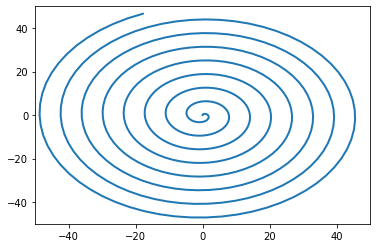

In [7]:
import matplotlib.animation as animation 
import matplotlib.pyplot as plt 
import numpy as np 
  
   
# creating a blank window
# for the animation 
fig = plt.figure() 
axis = plt.axes(xlim =(-50, 50),
                ylim =(-50, 50)) 
  
line, = axis.plot([], [], lw = 2) 
   
# what will our line dataset
# contain?
def init(): 
    line.set_data([], []) 
    return line, 
   
# initializing empty values
# for x and y co-ordinates
xdata, ydata = [], [] 
   
# animation function 
def animate(i): 
    # t is a parameter which varies
    # with the frame number
    t = 0.1 * i 
       
    # x, y values to be plotted 
    x = t * np.sin(t) 
    y = t * np.cos(t) 
       
    # appending values to the previously 
    # empty x and y data holders 
    xdata.append(x) 
    ydata.append(y) 
    line.set_data(xdata, ydata) 
      
    return line,
   
# calling the animation function     
anim = animation.FuncAnimation(fig, animate, init_func = init, 
                               frames = 500, interval = 20, blit = True) 
   
# saves the animation in our desktop
anim.save('growingCoil.svg', writer='imagemagick_file')

In [2]:
import matplotlib.animation as animation
print(animation.writers.list()

['pillow', 'ffmpeg', 'ffmpeg_file', 'imagemagick', 'imagemagick_file', 'html']


In [3]:
import drawsvg as draw

# 创建一个新的SVG画布
d = draw.Drawing(200, 200, origin='center')

# 加载静态图片
image = draw.Image(0, 0, "image1.png", 200, 200)
d.append(image)
image = draw.Image(0, 0, "image2.png", 200, 200)
d.append(image)

# 添加动画效果
animation = draw.Animate('opacity', dur='3s', repeatCount='indefinite')
# animation.set_values(1, 0)  # 透明度从1变为0
image.add(animation)

# 保存动态SVG文件
d.saveSvg('path/to/animated_image.svg')

AttributeError: 'Image' object has no attribute 'add'

In [4]:
draw.animate_video('example6.svg', draw_frame, duration=0.05,
                        gif_transparency=True, gif_alpha_threshold=128
                       )

AttributeError: module 'drawsvg' has no attribute 'animate_video'

In [ ]:
dw.Image(x, y, width, height, path=None, data=None,
         embed=False, mimeType=None, **kwargs)

d.append(dw.Image(0, 0, 200, 200, 'example1.png', embed=True))

In [5]:
import drawsvg as dw

In [15]:

group = draw.Group()
d.append(group)

In [16]:
d.append(dw.Image(0, 0, 200, 200, 'image1.png', embed=True))
d.append(dw.Image(0, 0, 200, 200, 'image2.png', embed=True))

In [17]:
print(d.as_svg())

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [18]:
d

In [19]:
d.save_svg('example.svg')

In [33]:
# Jupyter cell 1:
import drawsvg as dw
from drawsvg.widgets import AsyncAnimation
widget = AsyncAnimation(fps=1)

@widget.set_draw_frame  # Animation above is automatically updated
def draw_frame(ses=0):
    # Draw something...
    width = 2000
    height = 1800
    d = dw.Drawing(width, height, origin=(0, 0))
    d.append(dw.Image(0, 0, 2000, 1800, 'image1.png', embed=True))
    d.append(dw.Image(0, 0, 2000, 1800, 'image2.png', embed=True))
    return d

d = draw_frame()
d.save_svg('example.svg')


In [ ]:
d